# 折れ線グラフ（1変数）

## 概要

**折れ線グラフ（Line Chart）** は，主に **時間とともに変化する量的変数** を対象に， その推移を **直線** で表現するグラフです．
横軸に日付や時刻等の変数をとり，縦軸に変化を追いたい量的変数を取ります．

![](../figs/charts/lines.png)

例えば上図は，`ONE PIECE`の掲載位置の推移を表した折れ線グラフです．

## Plotlyによる作図方法

Plotlyにおいては，`plotly.express.line()`で作図できます．

```python
import plotly.express
fig = px.line(
    df, x='col_x', y='col_y')
```

例えば上記の例では，`df`の`col_x`列（時間的な変数であることが多いです）を横軸，`col_y`列を縦軸に取った棒グラフオブジェクト`fig`を作成します．

## MADB Labを用いた作図例

### 下準備

In [3]:
import pandas as pd
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

In [4]:
# 前処理の結果，以下に分析対象ファイルが格納されていることを想定
PATH_DATA = '../../data/preprocess/out/episodes.csv'
# Jupyter Book用のPlotlyのrenderer
RENDERER = 'plotly_mimetype+notebook'

In [5]:
# 連載週数の最小値
MIN_WEEKS = 5

In [6]:
def show_fig(fig):
    """Jupyter Bookでも表示可能なようRendererを指定"""
    fig.update_layout(margin=dict(t=50, l=25, r=25, b=25))
    # 凡例でグラフが潰れないよう調整
    fig.update_layout(legend={
        'yanchor': 'top',
        'xanchor': 'left',
        'x': 0.01, 'y': 0.99})
    fig.show(renderer=RENDERER)

In [7]:
df = pd.read_csv(PATH_DATA)

### 長期連載作品の掲載位置の推移

In [52]:
df_tmp = \
    df.groupby('cname')['pageStartPosition']\
    .agg(['count', 'mean']).reset_index()
df_tmp = \
    df_tmp.sort_values('count', ascending=False, ignore_index=True)\
    .head(10)
cname2position = df_tmp.groupby('cname')['mean'].first().to_dict()

In [53]:
df_plot = df[df['cname'].isin(list(cname2position.keys()))]\
    .reset_index(drop=True)
df_plot['position'] = df_plot['cname'].apply(
    lambda x: cname2position[x])
df_plot['datePublished'] = pd.to_datetime(df_plot['datePublished'])
df_plot = \
    df_plot.sort_values(['position', 'datePublished'], ignore_index=True)

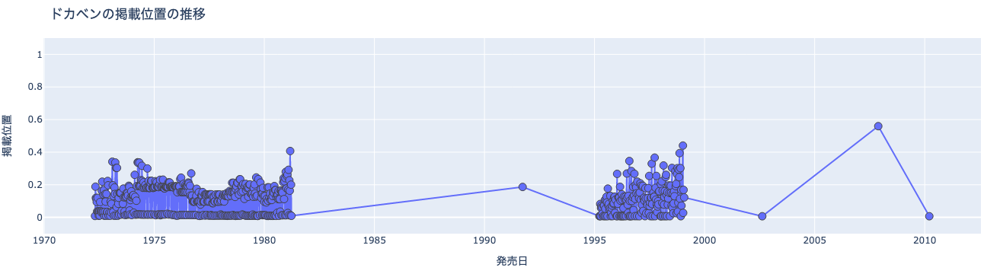

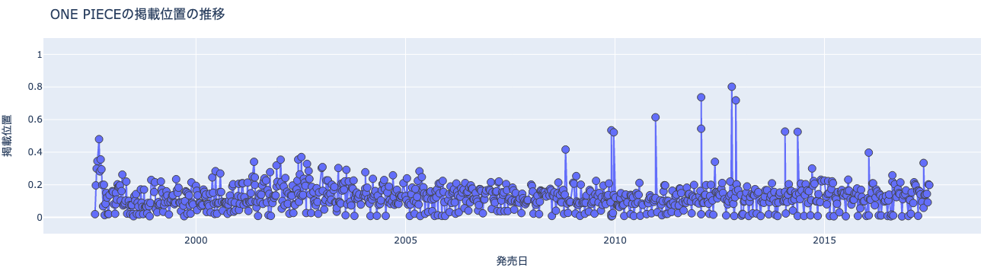

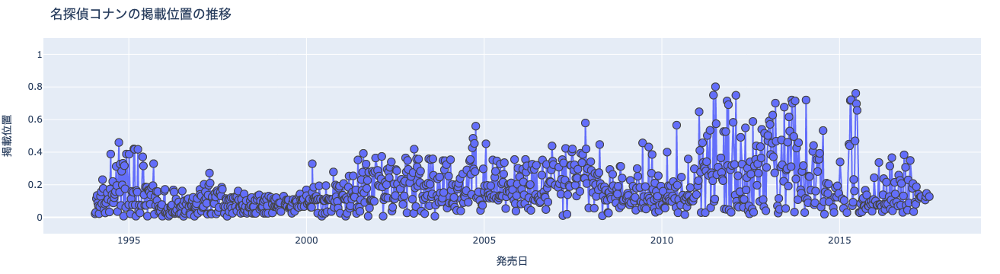

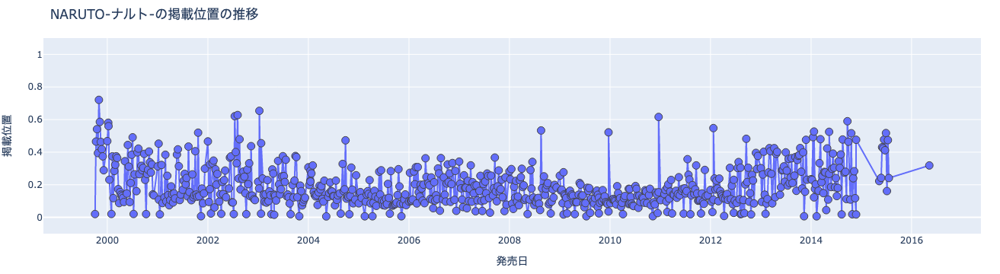

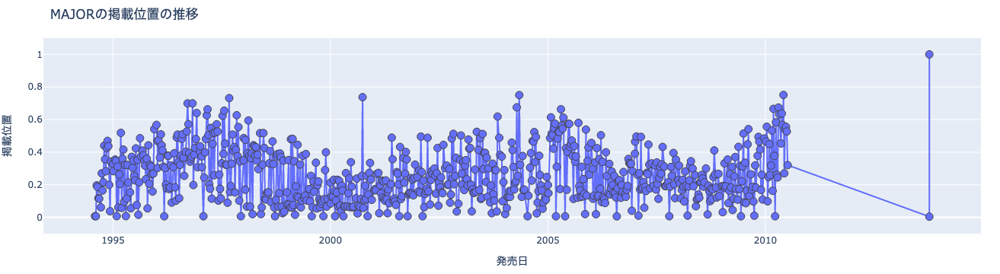

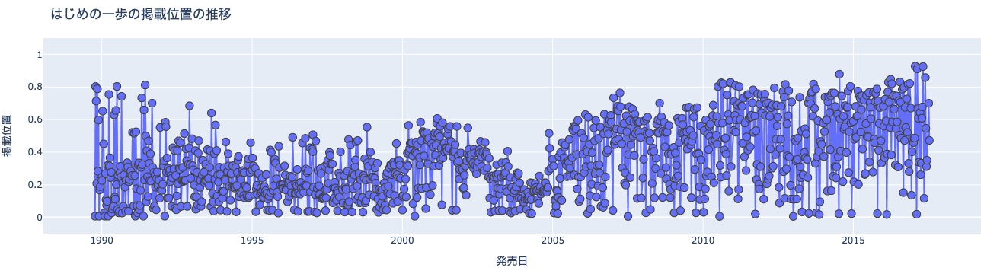

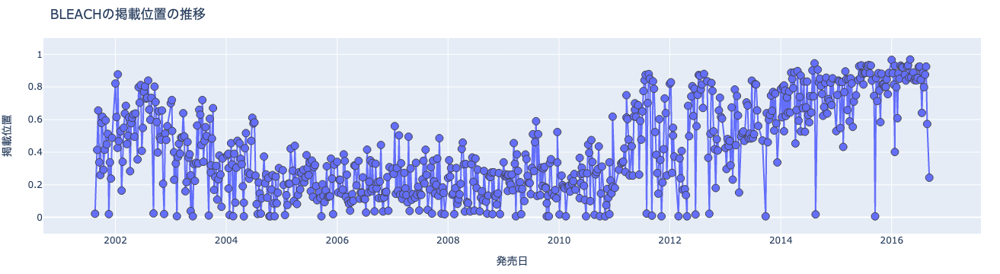

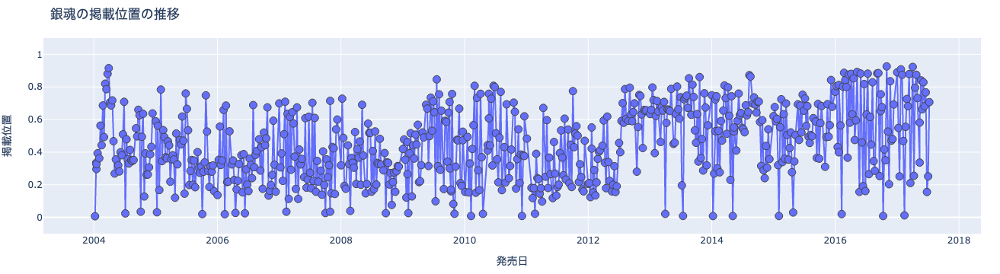

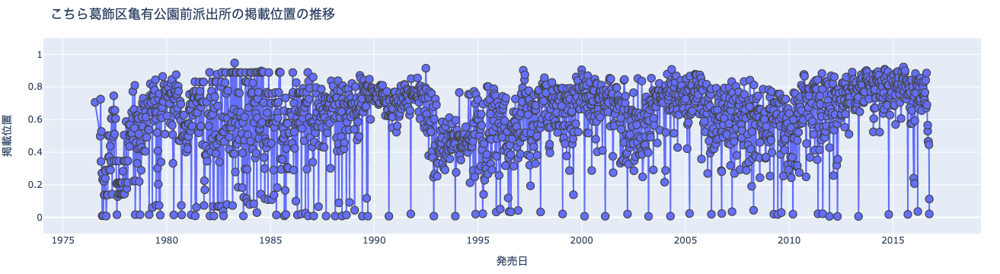

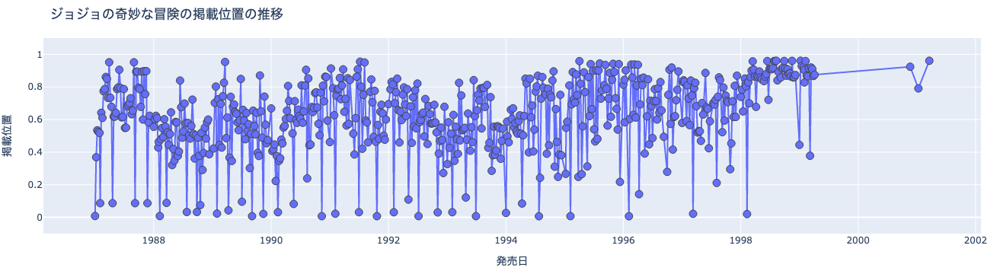

In [55]:
cnames = df_plot['cname'].unique()
for cname in cnames:
    df_c = df_plot[df_plot['cname']==cname].reset_index(drop=True)
    fig = px.line(
        df_c, x='datePublished', y='pageStartPosition',
        hover_data=['epname'], title=f'{cname}の掲載位置の推移')
    fig.update_traces(
        mode='lines+markers',
        marker=dict(line_width=1, size=10))
    fig.update_xaxes(title='発売日')
    fig.update_yaxes(title='掲載位置', range=[-.1, 1.1])
    fig.update_layout(hovermode='x unified')
    show_fig(fig)

マンガ好きの方であれば，マウスをホバーさせて各話情報を眺めるだけでも楽しめるのではないでしょうか？

### 番外編：`ONE PIECE`の企画ページを除外する

ところで，`ONE PIECE`にしては明らかに掲載位置が後ろすぎるデータが散見されます．

In [42]:
# 作品名ONE PIECEで抽出
df_op = df_plot[df_plot['cname']=='ONE PIECE'].reset_index(drop=True)

In [67]:
# 降順で先頭10例を表示
df_op.sort_values('pageStartPosition', ascending=False).head(10)

,mcname,miname,cname,epname,creator,pageStart,pageEnd,numberOfPages,datePublished,price,publisher,editor,pages,pageEndMax,pageStartPosition,position
695,週刊少年ジャンプ,週刊少年ジャンプ 2012年 表示号数44,ONE PIECE,グラばこ,尾田栄一郎,363.0,363.0,468.0,2012-10-15,229.0,集英社,瓶子吉久,1.0,453.0,0.801325,0.128448
663,週刊少年ジャンプ,週刊少年ジャンプ 2012年 表示号数5,ONE PIECE,グラばこ,尾田栄一郎,386.0,387.0,526.0,2012-01-22,238.0,集英社,瓶子吉久,2.0,524.0,0.736641,0.128448
701,週刊少年ジャンプ,週刊少年ジャンプ 2012年 表示号数49,ONE PIECE,グラばこ,尾田栄一郎,336.0,337.0,470.0,2012-11-19,229.0,集英社,瓶子吉久,2.0,468.0,0.717949,0.128448
617,週刊少年ジャンプ,週刊少年ジャンプ 2011年 表示号数3,ONE PIECE,ポリシー,尾田栄一郎,315.0,315.0,520.0,2010-12-20,238.0,集英社 ∥ シュウエイシャ,佐々木尚,1.0,513.0,0.614035,0.128448
662,週刊少年ジャンプ,週刊少年ジャンプ 2012年 表示号数5,ONE PIECE,チョッパーの福笑い,尾田栄一郎,285.0,285.0,526.0,2012-01-22,238.0,集英社,瓶子吉久,1.0,524.0,0.543893,0.128448
572,週刊少年ジャンプ,週刊少年ジャンプ 2009年 表示号数53,ONE PIECE,第565話 オーズの道,尾田栄一郎,257.0,273.0,481.0,2009-11-30,238.0,集英社 ∥ シュウエイシャ,佐々木尚,17.0,481.0,0.534304,0.128448
748,週刊少年ジャンプ,週刊少年ジャンプ 2014年 表示号数4,ONE PIECE,バギークリスマス,尾田栄一郎,279.0,279.0,532.0,2014-01-22,248.0,NaN,瓶子吉久,1.0,530.0,0.526415,0.128448
762,週刊少年ジャンプ,週刊少年ジャンプ 2014年 表示号数22,ONE PIECE,もしもルフィが、「NARUTO-ナルト-」の世界に行ったら…!?,尾田栄一郎,254.0,254.0,486.0,2014-05-12,236.0,NaN,瓶子吉久,1.0,484.0,0.524793,0.128448
576,週刊少年ジャンプ,週刊少年ジャンプ 2010年 表示号数03,ONE PIECE,メリー,尾田栄一郎,277.0,277.0,533.0,2009-12-21,238.0,集英社 ∥ シュウエイシャ,佐々木尚,1.0,531.0,0.521657,0.128448
4,週刊少年ジャンプ,週刊少年ジャンプ 1997年 表示号数39,ONE PIECE,第5話 “海賊王と大剣豪”,尾田栄一郎,225.0,243.0,482.0,1997-09-08,210.0,集英社 ∥ シュウエイシャ,鳥嶋和彦,19.0,469.0,0.479744,0.128448


本編ではない企画ページが含まれているようです．

そもそも合計データ数が

In [68]:
df_op.shape[0]

890

であるのに対し，最新の話数は

In [69]:
df_op.sort_values('datePublished').tail(1)['epname']

889    第869話 籠城
Name: epname, dtype: object

ですので，単純に考えると

In [70]:
890 - 869

21

話分のデータを除外する必要がありそうです．以下では，これらを除外することを考えます．

企画ページは本編と比較して短いことが考えられるので，5ページ以下のデータを抽出してみます．

In [71]:
(df_op['pages'] <= 5).sum()

21

In [72]:
df_op[df_op['pages'] <= 5][['pages', 'epname']].reset_index()

,index,pages,epname
0,182,3.0,トレ・なび
1,209,2.0,トレ・なび 第68回
2,232,2.0,トレ・なび 第91回
3,275,1.0,365連休
4,307,1.0,ジャンタクロース大集合!4コママンガスペシャル!! 白ひげのルフィ
5,494,1.0,グラばこ
6,532,1.0,消されたライセンス
7,570,3.0,アニ基地劇場版スペシャル『ONE PIECE FILM Strong World』
8,576,1.0,メリー
9,617,1.0,ポリシー


この抽出条件で良さそうです．
上記以外のデータで，再度折れ線グラフを描いてみましょう．

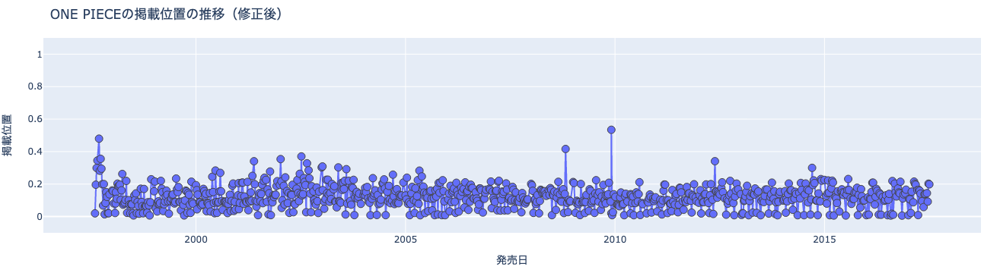

In [73]:
df_op_new = df_op[df_op['pages'] > 5].reset_index(drop=True)
fig = px.line(
    df_op_new, x='datePublished', y='pageStartPosition',
    hover_data=['epname'], 
    title=f'ONE PIECEの掲載位置の推移（修正後）')
fig.update_traces(
    mode='lines+markers',
    marker=dict(line_width=1, size=10))
fig.update_xaxes(title='発売日')
fig.update_yaxes(title='掲載位置', range=[-.1, 1.1])
fig.update_layout(hovermode='x unified')
show_fig(fig)

興味があるので，掲載位置で降順ソートしてみましょう．

In [74]:
df_op_new.sort_values('pageStartPosition', ascending=False)[
    ['miname', 'datePublished', 'epname', 'pageStartPosition']].\
    head(10)

,miname,datePublished,epname,pageStartPosition
564,週刊少年ジャンプ 2009年 表示号数53,2009-11-30,第565話 オーズの道,0.534304
4,週刊少年ジャンプ 1997年 表示号数39,1997-09-08,第5話 “海賊王と大剣豪”,0.479744
516,週刊少年ジャンプ 2008年 表示号数46,2008-10-27,第518話 闘技台,0.416122
233,週刊少年ジャンプ 2002年 表示号数30,2002-07-08,第235話 “突き上げる海流”,0.370288
6,週刊少年ジャンプ 1997年 表示号数41,1997-09-22,第7話 “友達”,0.355408
210,週刊少年ジャンプ 2002年 表示号数2,2002-01-08,第211話“王”,0.353846
3,週刊少年ジャンプ 1997年 表示号数37,1997-08-25,第4話 海軍大佐“斧手のモーガン”,0.345168
664,週刊少年ジャンプ 2012年 表示号数23,2012-05-21,第665話 CANDY,0.340909
180,週刊少年ジャンプ 2001年 表示号数23,2001-05-21,第181話 超カルガモクイズ,0.340757
240,週刊少年ジャンプ 2002年 表示号数37,2002-08-26,第242話 第2級犯罪者,0.328094


`ONE PIECE`は，`第565話 オーズの道`の除き，全て雑誌の前半に掲載されていることがわかります．
掲載位置が人気を測るバロメータと言われる`週刊少年ジャンプ`では驚異的なことです．